In [1]:
# load some standard packages 

# if new to python will probs need to install some of these packages

import numpy as np
import xarray as xr
# import datatree
import matplotlib
import math
import csv

# from xmip.postprocessing import _parse_metric

# import cartopy.crs as ccrs

# import xskillscore as xs
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.lines import Line2D

# import os
# import re
# import seaborn as sns
import pandas as pd

import matplotlib.gridspec as gridspec

import scipy.stats
from scipy.stats import norm
import matplotlib.pyplot as plt
# from mpl_toolkits.basemap import Basemap
# from mpl_toolkits.axes_grid1 import make_axes_locatable
# import matplotlib.patches as patches

# import gsw_xarray as gsw_xr # seawater calculations - might not need this one
import gsw as gsw
from geopy.distance import geodesic


/Users/isabelaconde/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# Code to plot interploted data of ctd transcets; for temp, salinity and density 

- chengyuen has nutrients. on a 1dbar by 1 km interpolated grid
- this one grid 0.25 km - finer scale measurements


### Pull ctd data and plot locations 

- Some code from Megann Jeffers plot_ADCP_transects.ipynb

In [ ]:
# check file path okay and nc file can be read - i've been having issues :/

file_path = '/Volumes/Voyages/in2024_v04/ctd/processing/in2024_v04/cap/cappro/avg/in2024_v04008CtdAvg.nc'
if os.path.exists(file_path):
    try:
        with open(file_path, 'rb') as f:
            f.read(100)  # Read the first 100 bytes
        print(f"File {file_path} is accessible.")
    except Exception as e:
        print(f"Failed to read {file_path}: {e}")
else:
    print(f"File {file_path} does not exist.")

In [2]:
# read_nc_file function adapted from megan's code
def read_nc_file(file):

    # ds = xr.open_dataset(file)
    ds=xr.open_dataset(file, engine='netcdf4')

    # ds = xr.open_dataset(file)
    pressure = ds['pressure'].values
    temperature = ds['temperature'].values
    salinity = ds['salinity'].values
    oxygen = ds['oxygen'].values
    latitude = ds['latitude'].values[0]
    longitude = ds['longitude'].values[0]
    time = ds['time'].values[0]

    SA = gsw.SA_from_SP(salinity, pressure, longitude, latitude)


    # calculate conservative temperature 

    CT = gsw.CT_from_t(SA, temperature, pressure)

    # calulate density 

    density = gsw.density.rho(SA, CT,pressure)
    # print(density)


    depth = gsw.z_from_p(pressure, latitude)
    # print(depth)

    # Create an xarray DataArray with explicit dimension names
    # depth_da = xr.DataArray(
    #     depth,
    #     dims=['pressure'],
    #     coords={'pressure': pressure}
    # )

    # Expand dimensions to include latitude, longitude, and time
    # depth_da = depth_da.expand_dims({'latitude': [latitude], 'longitude': [longitude], 'time': [time]}, axis=(0, 1, 3))

    # Create an xarray DataArray with explicit dimension names
    density_da = xr.DataArray(
        depth,
        dims=['pressure'],
        coords={'pressure': pressure}
    )

    pressure_da = xr.DataArray(
        pressure,
        dims=['depth'],
        coords={'depth': depth}
    )

    # Expand dimensions to include latitude, longitude, and time
    density_da =density_da.expand_dims({'latitude': [latitude], 'longitude': [longitude], 'time': [time]}, axis=(0, 1, 3))
    # density = xr.DataArray(density, dims=['latitude', 'longitude','time', 'pressure'], coords={'latitude': latitude, 'longitude': longitude,'time': time,'pressure':pressure})

    # Create a new xarray dataset with explicit dimension names
        # Create the dataset
    new_ds = xr.Dataset(
        {
            'temperature': (('longitude', 'latitude', 'depth', 'time'), temperature),
            'salinity': (('longitude', 'latitude', 'depth', 'time'), salinity),
            'oxygen': (('longitude', 'latitude', 'depth', 'time'), oxygen),
            'density': (('longitude', 'latitude', 'depth', 'time'), density_da.data),
            'pressure': (pressure_da.dims, pressure_da.data)
        },
        coords={
            'latitude': ('latitude', [latitude]),
            'longitude': ('longitude', [longitude]),
            'time': ('time', [time]),
            'depth': ('depth', depth),
        }
    )
    return new_ds

data_list = []

def open_nc_files(folder_path):
    # List all files in the folder
    files = os.listdir(folder_path)
    
    # Filter out only .nc files
    nc_files = [file for file in files if file.endswith('.nc')]
    
    # Open and process each .nc file
    for nc_file in nc_files:
        file_path = os.path.join(folder_path, nc_file)

        # Extract the numeric part '046' from the filename
        numeric_part = ''.join(filter(str.isdigit, nc_file))[-3:]
        
        # Create the variable name
        variable_name = f"ctd_{numeric_part}"
        try:
            dataset = read_nc_file(file_path)
            # Assign the dataset to the variable name in the global scope
            globals()[variable_name] = dataset

            latitude = dataset['latitude'].values[0]
            longitude = dataset['longitude'].values[0]
            

            data_list.append({
                'ctd': variable_name,
                'latitude': latitude,
                'longitude': longitude
            })

        except Exception as e:
            print(f"Failed to open {nc_file}: {e}")
    df = pd.DataFrame(data_list)
    df.to_csv('/Users/isabelaconde/Desktop/ctd_coordinates.csv', index=False)

# Specify the folder containing .nc files
folder_path = '/Users/isabelaconde/Desktop/avg'


open_nc_files(folder_path)


variable_names = [var_name for var_name in globals() if var_name.startswith('ctd_')] # run before loading ctd_ops dataset

In [13]:

# Replace 'path_to_file.xlsx' with the path to your Excel file
file_path = '/Users/isabelaconde/Desktop/ctd_file_mapping.xlsx'

# Read only columns C and F from the Excel file
df = pd.read_excel(file_path, sheet_name='Sheet1')


# deep tow camera lines for solitary
dtc_sol = pd.read_csv('/Users/isabelaconde/Desktop/sol_lines.csv')
dtc_sol

# deep tow camera lines for richmond
dtc_rich = pd.read_csv('/Users/isabelaconde/Desktop/richmond_dtc_2406.csv')

# ctd ops for microrider dat files
ctd_ops = []
for i in range(len(df['File name'])):
    if pd.notna(df['File name'][i]):
        # print(df['ctd num'][i])
        ctd_ops.append(df['ctd num'][i])



In [96]:
dtc_sol

,longitude,latitude,OpCode,Line_no
0,153.731919,-30.114373,INV2024_VO4_01_17,17
1,153.731919,-30.114373,INV2024_VO4_01_17,17
2,153.731940,-30.114342,INV2024_VO4_01_17,17
3,153.731940,-30.114342,INV2024_VO4_01_17,17
4,153.731940,-30.114342,INV2024_VO4_01_17,17
...,...,...,...,...
68243,153.714188,-30.143370,INV2024_V04_35_18,18
68244,153.714188,-30.143370,INV2024_V04_35_18,18
68245,153.714188,-30.143370,INV2024_V04_35_18,18
68246,153.714188,-30.143370,INV2024_V04_35_18,18


# Solitary Caynon

Read off map for transects


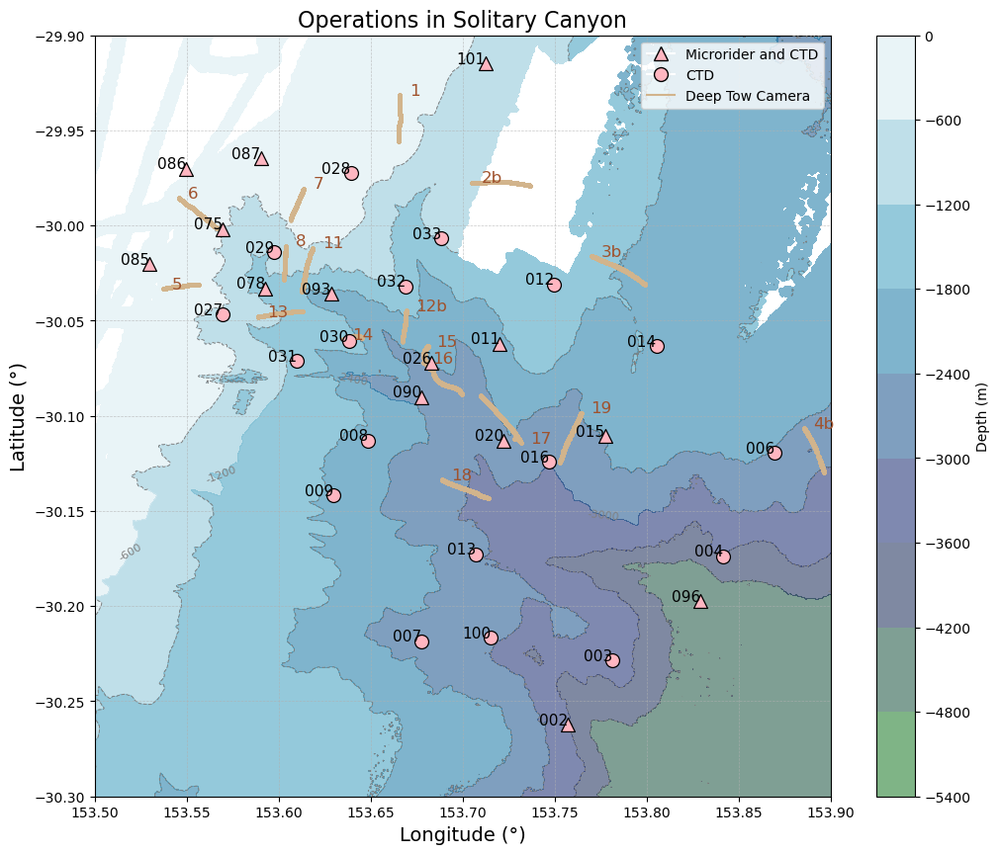

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

latitudes = []
longitudes = []

bathy = xr.open_dataset('/Volumes/Science-Team/BathyData/Solitary_Canyon/Solitary_Island_Canyon_High_Res_Bathy.nc')

# Collect relevant variable names
# variable_names = [var_name for var_name in globals() if var_name.startswith('ctd_')]

# Extract coordinates from each dataset
for var_name in variable_names:
    dataset = globals()[var_name]
    latitudes.append(dataset['latitude'].values[0])
    longitudes.append(dataset['longitude'].values[0])

# Define tolerance for considering points as duplicates
tolerance = 1e-2

# Function to filter out points that are within the given tolerance
def filter_duplicate_points(lons, lats, names, tol):
    unique_lons = []
    unique_lats = []
    unique_names = []
    
    for lon, lat, name in zip(lons, lats, names):
        if all(np.sqrt((lon - ulon)**2 + (lat - ulat)**2) > tol for ulon, ulat in zip(unique_lons, unique_lats)):
            unique_lons.append(lon)
            unique_lats.append(lat)
            unique_names.append(name)
    
    return unique_lons, unique_lats, unique_names

# Filter points
filtered_longitudes, filtered_latitudes, filtered_variable_names = filter_duplicate_points(longitudes, latitudes, variable_names, tolerance)

# Load bathymetry data
bathy_data = bathy.Band1

# Create a meshgrid for the contour plot
lon_bathy, lat_bathy = np.meshgrid(bathy.lon, bathy.lat)

# Define the list of variable names to be plotted with a red outline

# Plotting function with enhanced visuals
def plot_with_contours(ax, longitudes, latitudes, variable_names, lon_bathy, lat_bathy, bathy_data):
    for i, (lon, lat, var_name) in enumerate(zip(longitudes, latitudes, variable_names)):
        marker = '^' if var_name in ctd_ops else 'o'
        sc = ax.scatter(lon, lat, c='#ffb6c1', s=100, edgecolor='k', linewidth=0.9, zorder=5,marker=marker)
        ax.annotate(var_name[-3:], (lon, lat), fontsize=11, ha='right', color='k', zorder=6)
    
    # Add contour lines
    contour = ax.contour(lon_bathy, lat_bathy, bathy_data, colors='grey', linewidths=0.7, zorder=1)
    ax.clabel(contour, inline=True, fontsize=8, fmt='%1.0f')

    ax.set_title('Operations in Solitary Canyon', fontsize=16)
    ax.set_xlabel('Longitude (°)', fontsize=14)
    ax.set_ylabel('Latitude (°)', fontsize=14)
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)

    # Adding a color bar to show depth variation
    contour_filled = ax.contourf(lon_bathy, lat_bathy, bathy_data, cmap='ocean', alpha=0.5, zorder=0)
    fig.colorbar(contour_filled, ax=ax, orientation='vertical', label='Depth (m)')

# Function to plot camera tow lines
def plot_camera_tow_lines(ax, dtc_sol):
    grouped = dtc_sol.groupby('Line_no')
    for name, group in grouped:
        ax.plot(group['longitude'], group['latitude'], linestyle='-', marker='o', color='tan', markersize=2, linewidth=1, label=f'Tow Line {name}')
        ax.annotate(str(name), (group['longitude'].values[0]  + 0.005, group['latitude'].values[0]), fontsize=12, ha='left', color='sienna', zorder=6)


# Plot showing Solitary Canyon
fig, ax = plt.subplots(figsize=(12, 10))
plot_with_contours(ax, filtered_longitudes, filtered_latitudes, filtered_variable_names, lon_bathy, lat_bathy, bathy_data)

# Plot camera tow lines
plot_camera_tow_lines(ax, dtc_sol)

# Create legend elements
ctd_microrider = plt.Line2D([0], [0], marker='^', color='w', label='Microrider and CTD', markerfacecolor='#ffb6c1', markeredgecolor='k', markersize=10)
ctd_only = plt.Line2D([0], [0], marker='o', color='w', label='CTD', markerfacecolor='#ffb6c1', markeredgecolor='k', markersize=10)
camera_tow = plt.Line2D([0], [0], linestyle='-', color='tan', label='Deep Tow Camera')

# Add the legend to the plot
ax.legend(handles=[ctd_microrider, ctd_only, camera_tow], loc='upper right')

ax.set_ylim([-30.3, -29.9])
ax.set_xlim([153.5, 153.9])

plt.show()


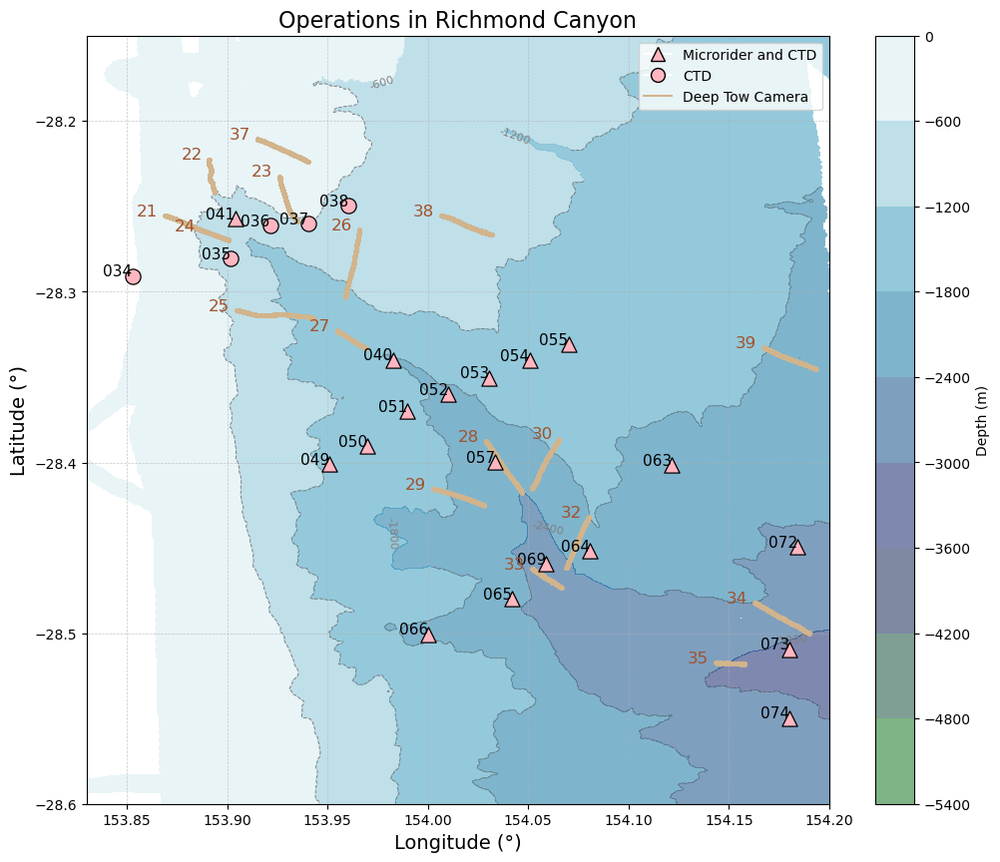

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

latitudes = []
longitudes = []

bathy = xr.open_dataset('/Volumes/Science-Team/BathyData/Richmond_Canyon/RichmondCanyon_50m.nc')

# Collect relevant variable names
# variable_names = [var_name for var_name in globals() if var_name.startswith('ctd_')]

# Extract coordinates from each dataset
for var_name in variable_names:
    dataset = globals()[var_name]
    latitudes.append(dataset['latitude'].values[0])
    longitudes.append(dataset['longitude'].values[0])

# Load the dataset for camera tow lines (replace with your actual file path)
# dtc_sol = pd.read_csv('path_to_your_dtc_sol_csv_file.csv')

# Define tolerance for considering points as duplicates
tolerance = 1e-2

# Function to filter out points that are within the given tolerance
def filter_duplicate_points(lons, lats, names, tol):
    unique_lons = []
    unique_lats = []
    unique_names = []
    
    for lon, lat, name in zip(lons, lats, names):
        if all(np.sqrt((lon - ulon)**2 + (lat - ulat)**2) > tol for ulon, ulat in zip(unique_lons, unique_lats)):
            unique_lons.append(lon)
            unique_lats.append(lat)
            unique_names.append(name)
    
    return unique_lons, unique_lats, unique_names

# Filter points
filtered_longitudes, filtered_latitudes, filtered_variable_names = filter_duplicate_points(longitudes, latitudes, variable_names, tolerance)

# Load bathymetry data
bathy_data = bathy.Band1

# Create a meshgrid for the contour plot
lon_bathy, lat_bathy = np.meshgrid(bathy.lon, bathy.lat)

# Define the list of variable names to be plotted with a red outline

# Plotting function with enhanced visuals
def plot_with_contours(ax, longitudes, latitudes, variable_names, lon_bathy, lat_bathy, bathy_data):
    for i, (lon, lat, var_name) in enumerate(zip(longitudes, latitudes, variable_names)):
        marker = '^' if var_name in ctd_ops else 'o'
        sc = ax.scatter(lon, lat, c='#ffb6c1', s=120, edgecolor='k', linewidth=0.9, zorder=5, marker=marker)
        ax.annotate(var_name[-3:], (lon, lat), fontsize=11, ha='right', color='k', zorder=6)
    
    # Add contour lines
    contour = ax.contour(lon_bathy, lat_bathy, bathy_data, colors='grey', linewidths=0.7, zorder=1)
    ax.clabel(contour, inline=True, fontsize=8, fmt='%1.0f')

    ax.set_title('Operations in Richmond Canyon', fontsize=16)
    ax.set_xlabel('Longitude (°)', fontsize=14)
    ax.set_ylabel('Latitude (°)', fontsize=14)
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)

    # Adding a color bar to show depth variation
    contour_filled = ax.contourf(lon_bathy, lat_bathy, bathy_data, cmap='ocean', alpha=0.5, zorder=0)
    fig.colorbar(contour_filled, ax=ax, orientation='vertical', label='Depth (m)')

# Function to plot camera tow lines
def plot_camera_tow_lines(ax, dtc_rich):
    grouped = dtc_rich.groupby('Line_no')
    for name, group in grouped:
        ax.plot(group['longitude'], group['latitude'], linestyle='-', marker='o', color='tan', markersize=2, linewidth=1, label=f'Tow Line {name}')
        ax.annotate(str(name), (group['longitude'].values[0]  - 0.014, group['latitude'].values[0]), fontsize=12, ha='left', color='sienna', zorder=6)


# Plot showing Solitary Canyon
fig, ax = plt.subplots(figsize=(12, 10))

# Plot CTD points and bathymetry
plot_with_contours(ax, filtered_longitudes, filtered_latitudes, filtered_variable_names, lon_bathy, lat_bathy, bathy_data)

# Plot camera tow lines
plot_camera_tow_lines(ax, dtc_rich)


# Create legend elements
ctd_microrider = plt.Line2D([0], [0], marker='^', color='w', label='Microrider and CTD', markerfacecolor='#ffb6c1', markeredgecolor='k', markersize=10)
ctd_only = plt.Line2D([0], [0], marker='o', color='w', label='CTD', markerfacecolor='#ffb6c1', markeredgecolor='k', markersize=10)
camera_tow = plt.Line2D([0], [0], linestyle='-', color='tan', label='Deep Tow Camera')

# Add the legend to the plot
ax.legend(handles=[ctd_microrider, ctd_only, camera_tow], loc='upper right')

# Adjust plot limits
ax.set_ylim([ -28.6,-28.15])
ax.set_xlim([153.83, 154.2])

# Add legend for camera tow lines
# ax.legend(loc='upper right')

plt.show()


read off maps for transects

In [17]:
# define transects from map above

# transects for solitarry canyon 
transect1 = [ctd_002, ctd_003, ctd_004, ctd_006]
transect2 = [ctd_007, ctd_013, ctd_016, ctd_015, ctd_014]
transect3 = [ctd_009, ctd_008, ctd_026, ctd_011, ctd_012]
transect4 = [ctd_031,ctd_030, ctd_032, ctd_033]
transect5 = [ctd_027, ctd_076, ctd_029, ctd_028]
transect6 = [ctd_085, ctd_086, ctd_087]

In [41]:
Rtransect1 = [ctd_074,ctd_073,ctd_072]
Rtransect2 = [ctd_066,ctd_065,ctd_069,ctd_064,ctd_063]
Rtransect3 = [ctd_049,ctd_050,ctd_051,ctd_052,ctd_053,ctd_054,ctd_055]
Rtransect4 = [ctd_034,ctd_035,ctd_036,ctd_037,ctd_038]


## interpolate to get transects


In [19]:
# Megan's function to calculate distance between casts

def calculate_distances(casts):
    base_coord = (casts[0]['latitude'], casts[0]['longitude'])
    distances = [0]  # Distance from the first included cast is 0
    for cast in casts[1:]:
        coord = (cast['latitude'], cast['longitude'])
        distance = geodesic(base_coord, coord).kilometers
        distances.append(distance)
    return distances



In [20]:
def datasets_transects(transect):

    dist = calculate_distances(transect) 

    # Find the maximum depth across all transects using list comprehension
    max_depth = 4000
    # print(str(transect)+'okay')
    new_depth = -np.arange(0,max_depth, 1)

    # initialise empty arrays to store interpolated data
    temp_array = np.full((len(new_depth),len(transect)), np.nan)
    pressure_array = np.full((len(new_depth),len(transect)), np.nan)
    salinity_array = np.full((len(new_depth),len(transect)), np.nan)
    oxygen_array = np.full((len(new_depth),len(transect)), np.nan)
    density_array = np.full((len(new_depth),len(transect)), np.nan)



    for i in range(len(transect)):
        # print(transect[i]['temperature'])
        # print(da_pressure)

        old_depth= transect[i]['temperature'].drop_vars('time').drop_vars('longitude').drop_vars('latitude').depth.values


        temp = xr.DataArray(transect[i]['temperature'].squeeze(['time','latitude','longitude']).drop_vars(['time','longitude','latitude']), coords={'depth': old_depth})
        pressure = xr.DataArray(transect[i]['pressure'],  coords={'depth': old_depth})
        salinity = xr.DataArray(transect[i]['salinity'].squeeze(['time','latitude','longitude']).drop_vars(['time','longitude','latitude']), coords={'depth': old_depth})
        oxygen = xr.DataArray(transect[i]['oxygen'].squeeze(['time','latitude','longitude']).drop_vars(['time','longitude','latitude']), coords={'depth': old_depth})
        density = xr.DataArray(transect[i]['density'].squeeze(['time','latitude','longitude']).drop_vars(['time','longitude','latitude']), coords={'depth': old_depth})


        

        # # interpolate on to a constant grid 
        da_temp= temp.interp(depth = new_depth, method='linear')
        da_pressure = pressure.interp(depth = new_depth, method='linear')#.drop_vars('time')
        da_salinty = salinity.interp(depth = new_depth, method='linear')
        da_oxygen = oxygen.interp(depth = new_depth, method='linear')
        da_density = density.interp(depth = new_depth, method='linear')




    #     # temperature_values = transect1[i]['temperature'].values.flatten()  # Ensure 1D array
    #     # length = len(temperature_values)
        temp_array[:, i] = da_temp.values
        pressure_array[:, i] = da_pressure.values
        salinity_array[:, i] = da_salinty.values
        oxygen_array[:, i] = da_oxygen.values
        density_array[:, i] = da_density.values


    temp_array = xr.DataArray(temp_array, dims=['depth', 'distance'], coords={'depth': new_depth, 'distance': np.array(dist)})
    pressure_array = xr.DataArray(pressure_array, dims=['depth', 'distance'], coords={'depth': new_depth, 'distance': np.array(dist)})
    salinity_array = xr.DataArray(salinity_array, dims=['depth', 'distance'], coords={'depth': new_depth, 'distance': np.array(dist)})
    oxygen_array = xr.DataArray(oxygen_array, dims=['depth', 'distance'], coords={'depth': new_depth, 'distance': np.array(dist)})
    density_array = xr.DataArray(density_array, dims=['depth', 'distance'], coords={'depth': new_depth, 'distance': np.array(dist)})

    temp_transect= temp_array.interp(distance = np.arange(0,max(dist), 1), method='linear')
    pressure_transect= pressure_array.interp(distance = np.arange(0,max(dist), 1), method='linear')
    oxygen_transect= oxygen_array.interp(distance = np.arange(0,max(dist), 1), method='linear')
    salinity_transect= salinity_array.interp(distance = np.arange(0,max(dist), 1), method='linear')
    density_transect= density_array.interp(distance = np.arange(0,max(dist), 1), method='linear')

    # #Create a new xarray dataset with explicit dimension names
    transect_ds = xr.Dataset(
        {
            'temperature': (temp_transect.dims, temp_transect.data),
            'salinity': (salinity_transect.dims, salinity_transect.data),
            'oxygen': (oxygen_transect.dims, oxygen_transect.data),
            'density': (density_transect.dims, density_transect.data),
            'pressure': (pressure_transect.dims, pressure_transect.data)
        },
        coords={
            'depth': (temp_transect['depth'].dims, temp_transect.depth.values),
            'distance': (temp_transect['distance'].dims, temp_transect.distance.values)
        }
    )


    return transect_ds


In [43]:
datasets_transect1 = datasets_transects(transect1)
datasets_transect2 = datasets_transects(transect2)
datasets_transect3 = datasets_transects(transect3)
datasets_transect4 = datasets_transects(transect4)
datasets_transect5 = datasets_transects(transect5)
datasets_transect6 = datasets_transects(transect6)

thalweg_sol = datasets_transects([ctd_086,ctd_075,ctd_029,ctd_093,ctd_030,ctd_026,ctd_020,ctd_016,ctd_096])

thalweg_rich = datasets_transects([ctd_041,ctd_040,ctd_052,ctd_057,ctd_064,ctd_074])

# datasets_transect1.isel(distance=0).plot()

In [116]:
dt_thalweg_sol=[ctd_086,ctd_075,ctd_029,ctd_093,ctd_030,ctd_026,ctd_020,ctd_016,ctd_096]
dt_thalweg_rich=[ctd_041,ctd_040,ctd_052,ctd_057,ctd_064,ctd_074]

In [105]:
def plot_interp_profiles(datasets_transects,dt, bathy_data):


        
    # Assuming datasets_transect1 is a dictionary with 'distance', 'depth', and the variables as keys
    distance = datasets_transects['distance'].values
    depth = datasets_transects['depth'].values
    variables = ['temperature', 'salinity', 'oxygen', 'density']
    titles = ['Temperature', 'Salinity', 'Oxygen', 'Density']
    colormaps = ['viridis', 'plasma', 'inferno', 'PuBuGn_r']

    max_depth = min(datasets_transects['depth'].values)

    # Create a meshgrid for the pcolormesh
    X, Y = np.meshgrid(distance, depth)

    # Plotting
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))

    for i, ax in enumerate(axes.flat):
        var = datasets_transects[variables[i]].values
        pcm = ax.pcolormesh(X, Y, var, shading='auto', cmap=colormaps[i])
        # pcm = ax.contourf(X, Y, var, cmap=colormaps[i], levels=10)

        
        # Adding a color bar
        cbar = fig.colorbar(pcm, ax=ax, orientation='vertical')
        cbar.set_label(titles[i], rotation=270, labelpad=15)

        # Adding labels and title
        ax.set_xlabel('Distance (km)', fontsize=12)
        ax.set_ylabel('Depth (m)', fontsize=12)
        ax.set_title(f'CTD Transect {titles[i]} Plot', fontsize=15)

        # Customizing the axes
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))  # Ensuring x-axis labels are integers
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_ylim([max_depth, 0])  # Invert y-axis to have depth increasing downwards

        # Adding grid for better readability
        ax.grid(True, linestyle='--', alpha=0.6)

        # Check if bathymetry values are non-zero
        if np.any(bathy_data != 0):
            start_lat, start_lon = dt[0].latitude.values[0], dt[0].longitude.values[0]  # Replace with your actual start point
            end_lat, end_lon = dt[len(dt)-1].latitude.values[0], dt[len(dt)-1].longitude.values[0]     # Replace with your actual end point
            num_points = 100  # Number of points along the transect
            lats = np.linspace(start_lat, end_lat, num_points)
            lons = np.linspace(start_lon, end_lon, num_points)
            transect_data = bathy_data.interp(lat=xr.DataArray(lats, dims="points"), lon=xr.DataArray(lons, dims="points"))

                    # Create a twin axis for the distance
            ax2 = ax.twiny()
            ax2.plot(transect_data['lon'], transect_data['Band1'], label='Transect Data')
            # Set the limits of the x-axes to be the same
            ax2.set_xlim(start_lon, end_lon)
            ax2.set_ylim(transect_data['Band1'].min(),0)




    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()


### Solitary Canyon

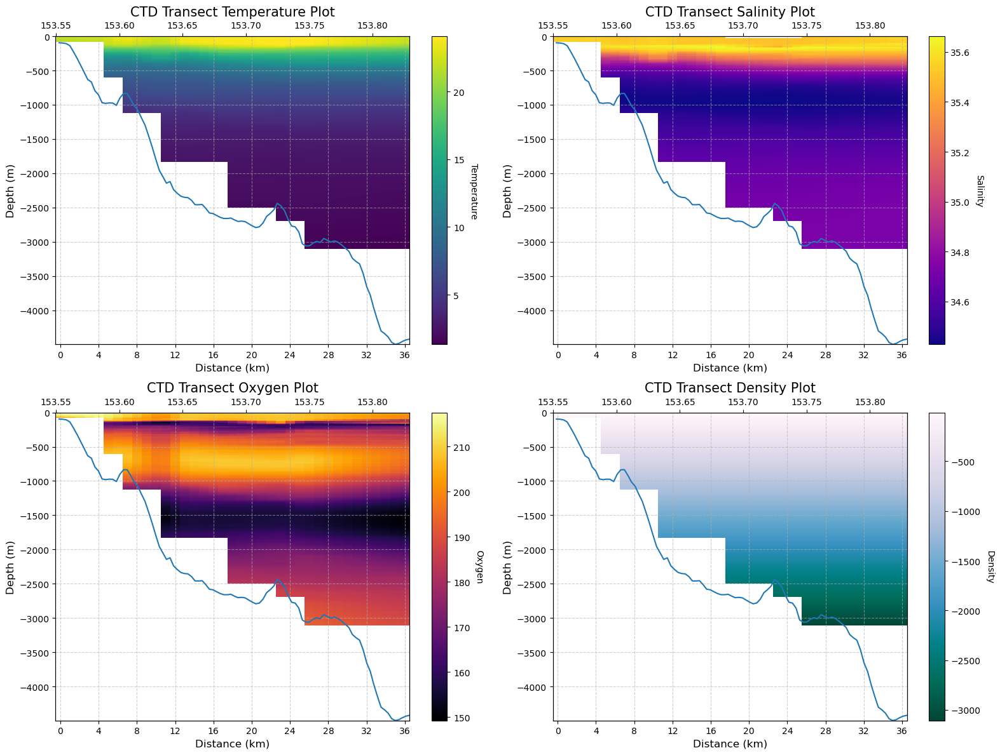

In [113]:
plot_interp_profiles(thalweg_sol,dt_thalweg_sol, sol_b)

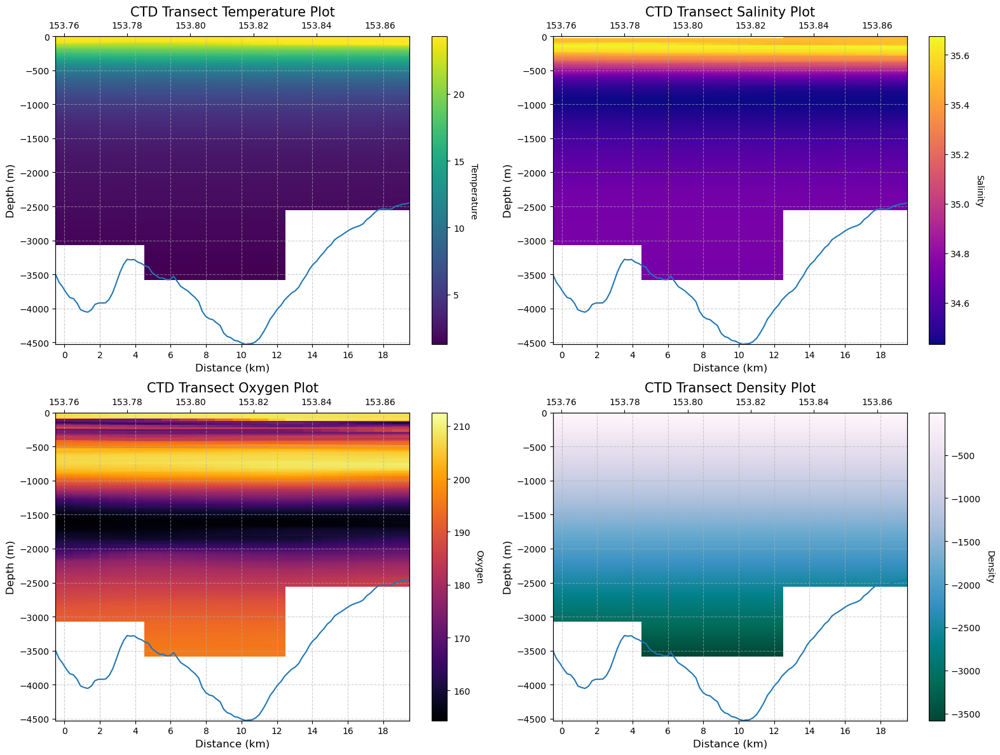

In [106]:
plot_interp_profiles(datasets_transect1,transect1,sol_b)

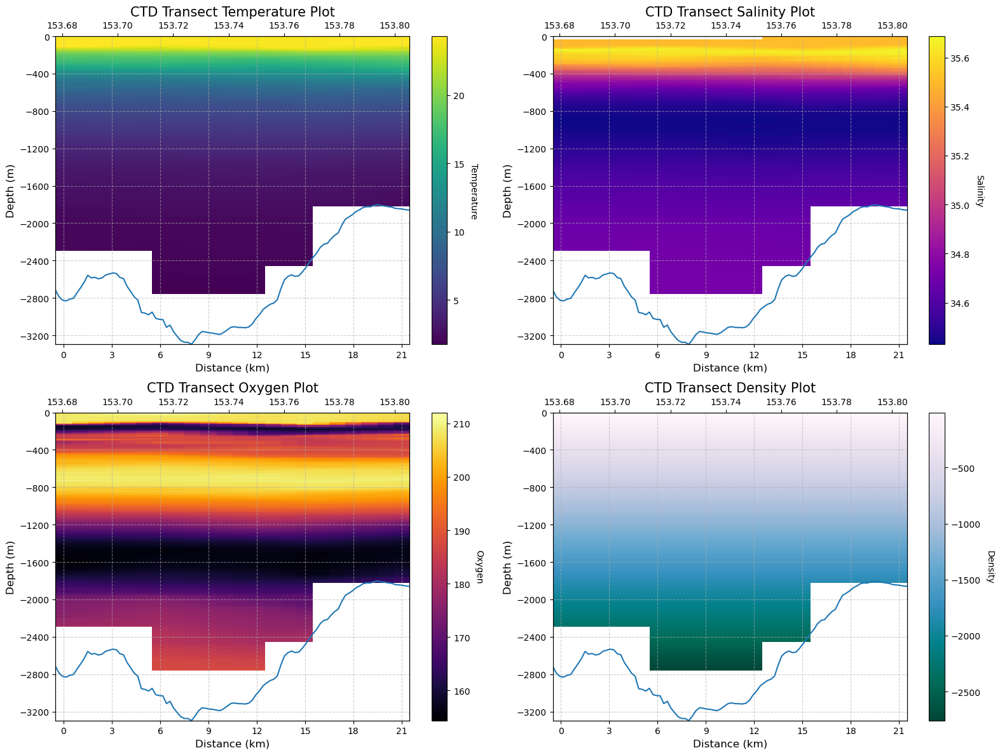

In [107]:
plot_interp_profiles(datasets_transect2,transect2,sol_b)

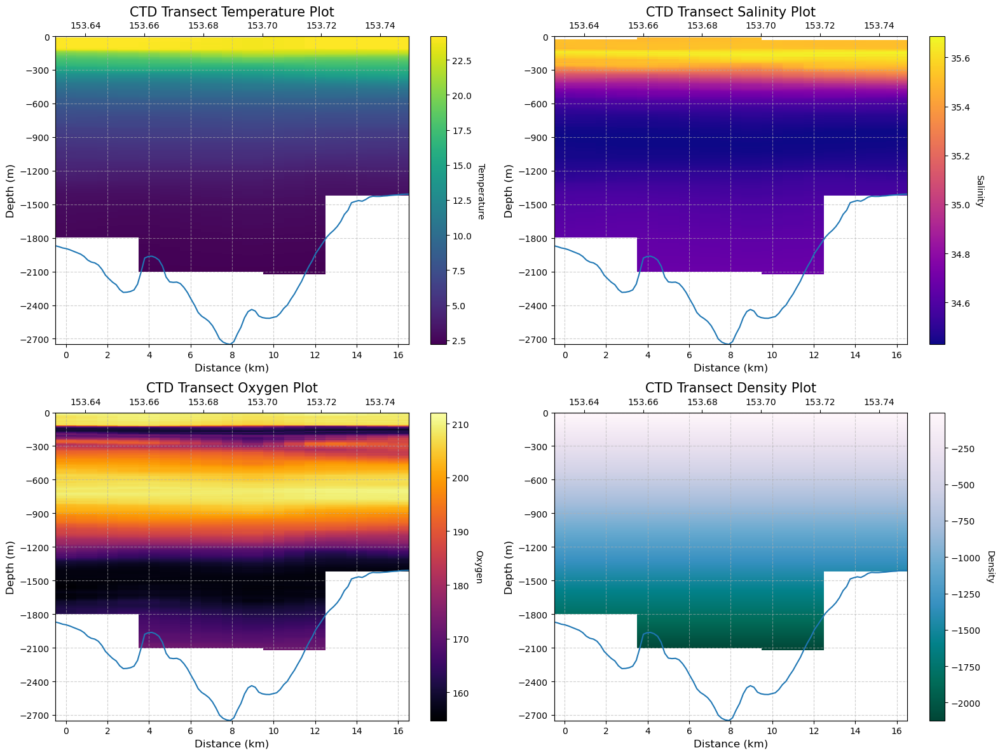

In [108]:
plot_interp_profiles(datasets_transect3,transect3,sol_b)

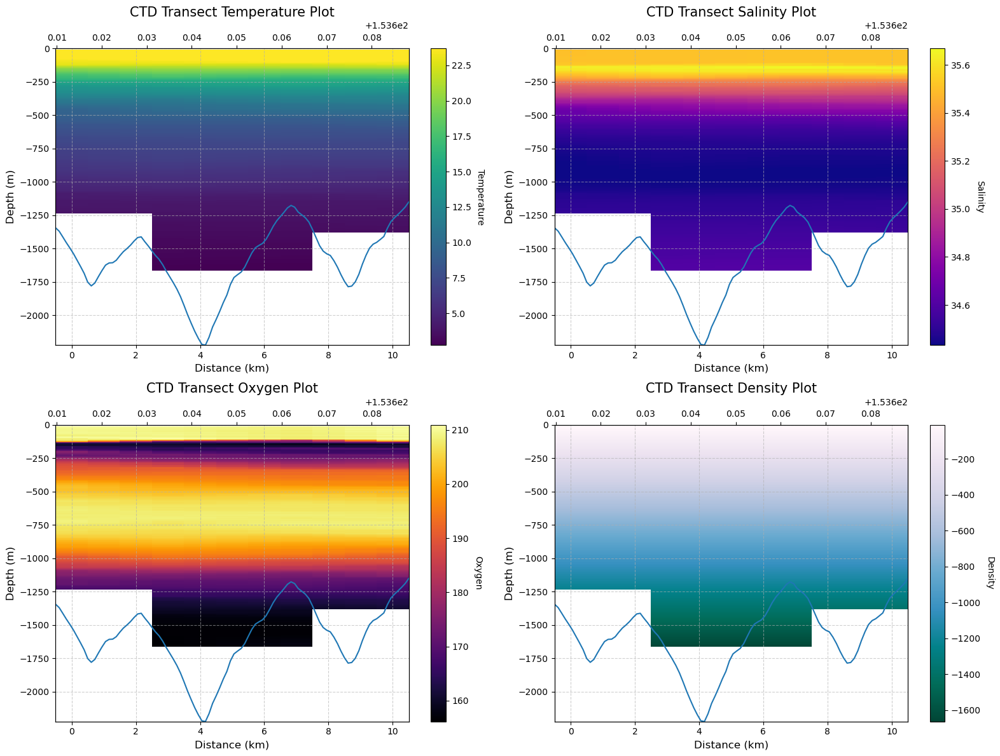

In [109]:
plot_interp_profiles(datasets_transect4,transect4,sol_b)

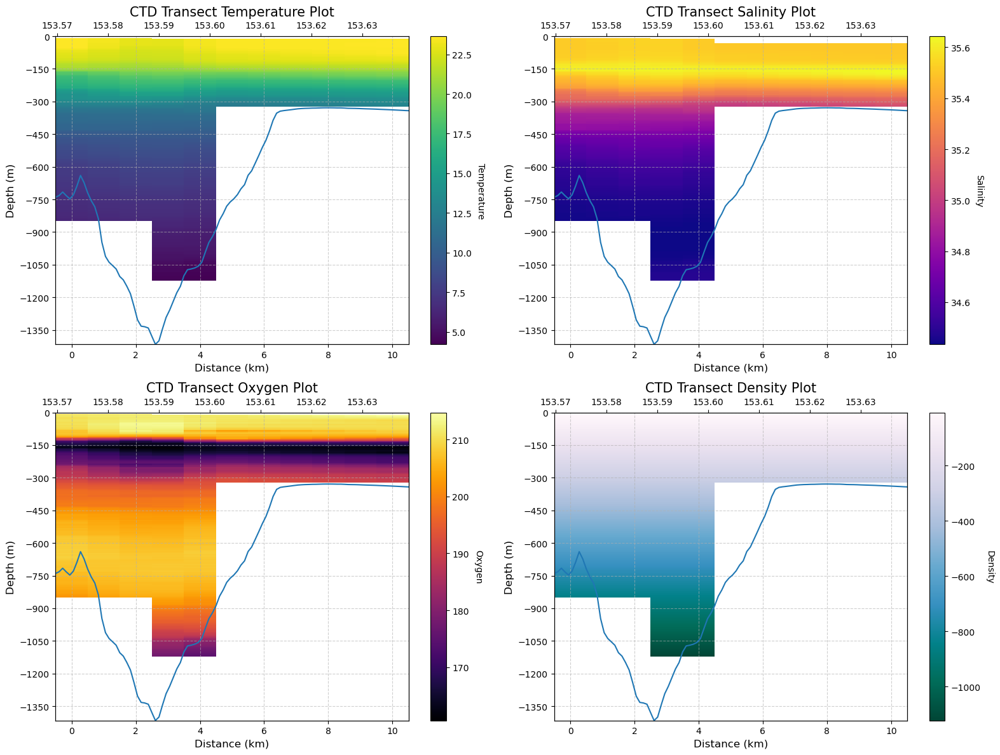

In [110]:
plot_interp_profiles(datasets_transect5,transect5,sol_b)

# Richmond Canyon 



In [27]:
datasets_Rtransect1 = datasets_transects(Rtransect1)
datasets_Rtransect2 = datasets_transects(Rtransect2)
datasets_Rtransect3 = datasets_transects(Rtransect3)
datasets_Rtransect4 = datasets_transects(Rtransect4)


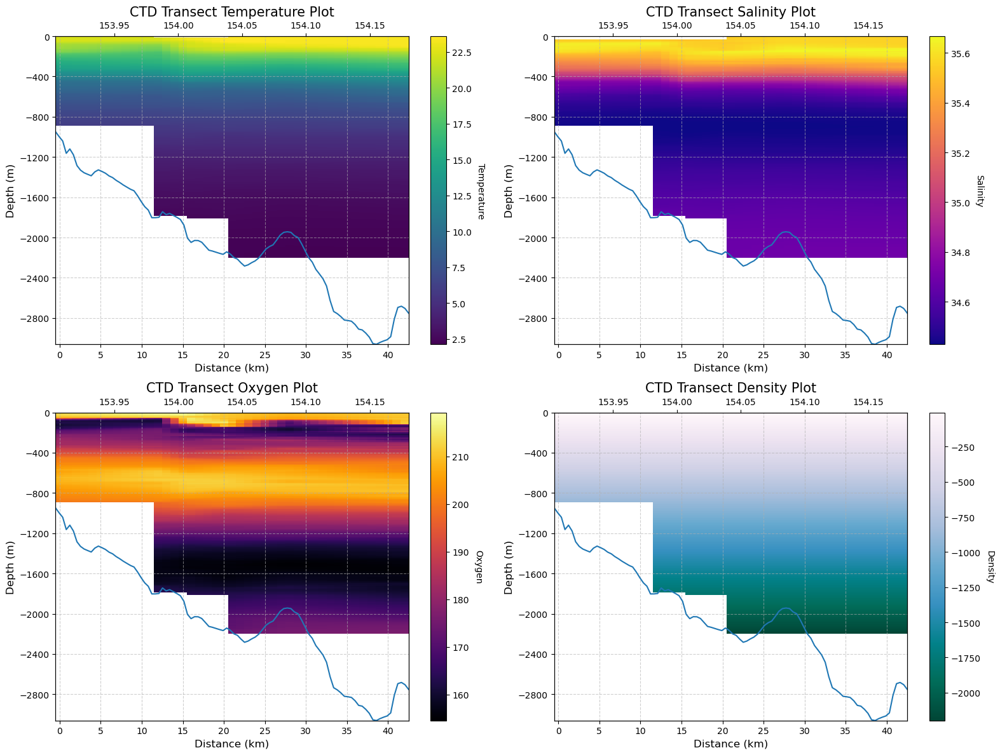

In [117]:
plot_interp_profiles(thalweg_rich,dt_thalweg_rich,rich_b)

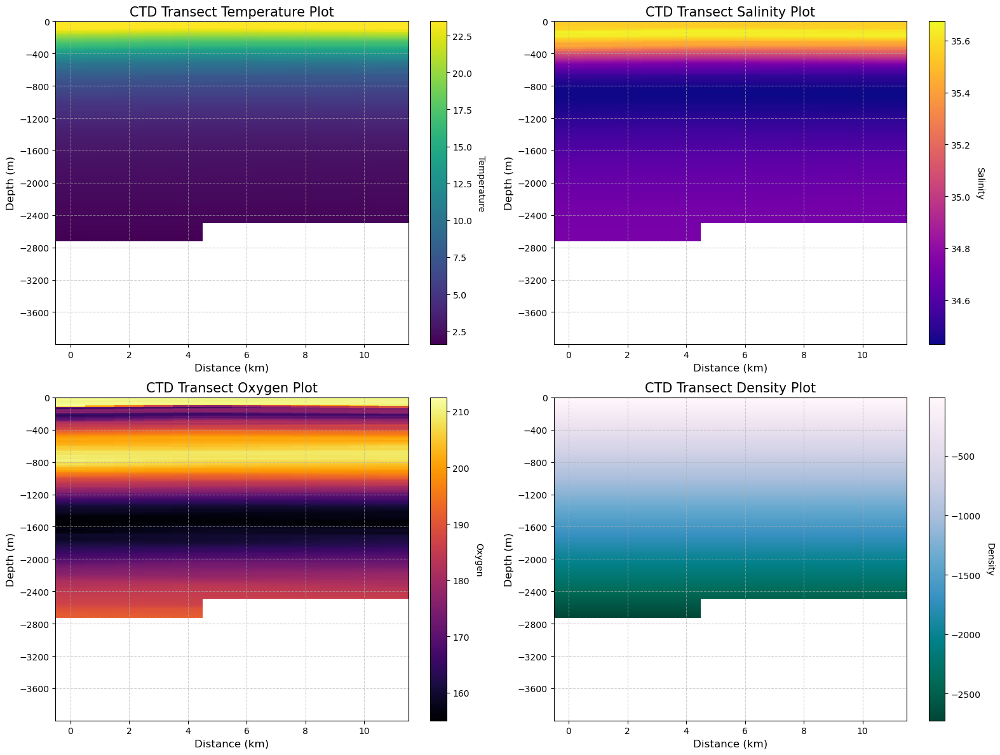

In [859]:
plot_interp_profiles(datasets_Rtransect1)

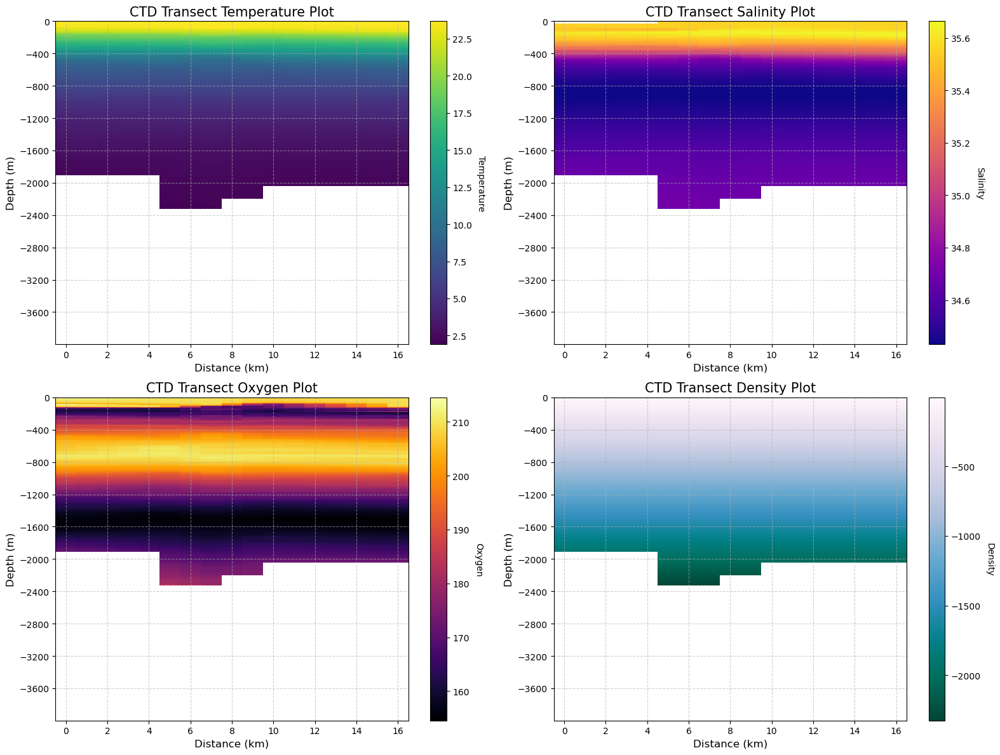

In [860]:
plot_interp_profiles(datasets_Rtransect2)

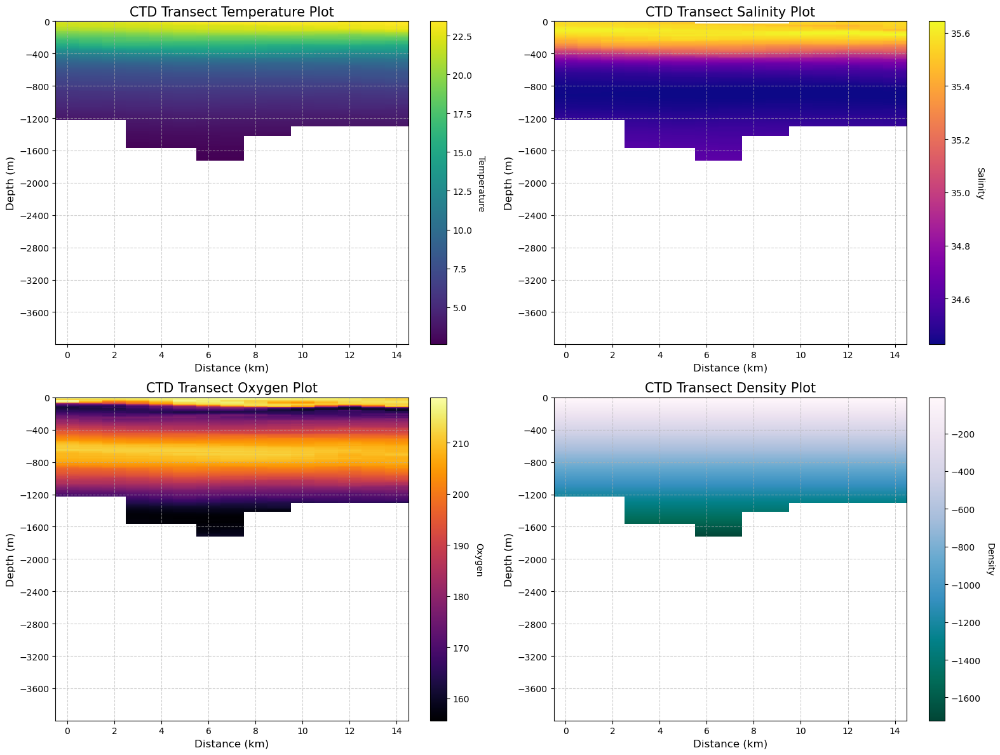

In [861]:
plot_interp_profiles(datasets_Rtransect3)

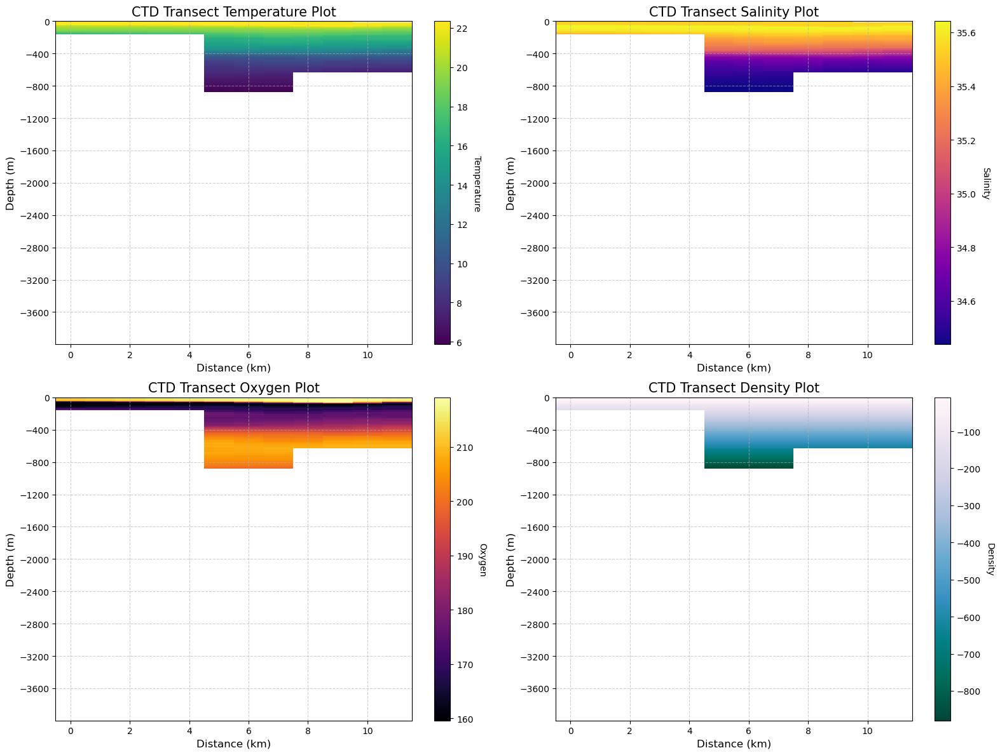

In [862]:
plot_interp_profiles(datasets_Rtransect4)

# 3D plots of solitary canyon 

Not working well- on hold for now

In [873]:
datasets_Rtransect4


depth = datasets_Rtransect4.coords["depth"].values 
dist = datasets_Rtransect4.coords["distance"].values 
Band1 =datasets_Rtransect4.oxygen.values

In [32]:
import numpy as np
import plotly.graph_objects as go

# Example function to prepare 3D transect data with interpolation
def values_3d_transect(oxygen, depth, dist):
    target_lon = np.arange(0, 15.5, 0.5)

    # Create a meshgrid with original Lon and Depth
    Lon_orig, Depth = np.meshgrid(dist, depth)
    
    # Interpolate oxygen values to the target Lon grid
    Lon_interp, Depth_interp = np.meshgrid(target_lon, depth)
    oxygen_interp = np.empty_like(Lon_interp)
    
    for i in range(depth.size):
        oxygen_interp[i, :] = np.interp(target_lon, dist, oxygen[i, :], left=np.nan, right=np.nan)
    
    # Set the Y-axis as a constant
    Y = np.ones_like(Lon_interp)
    
    return Lon_interp, Depth_interp, Y, oxygen_interp

# Example data (replace with your actual data or provide how you're loading it)
# Assuming datasets_Rtransect1, datasets_Rtransect2, datasets_Rtransect3, datasets_Rtransect4 are defined
# Replace these with your actual data loading or generation logic
oxygen1 = datasets_Rtransect1.oxygen.values
oxygen2 = datasets_Rtransect2.oxygen.values
oxygen3 = datasets_Rtransect3.oxygen.values
oxygen4 = datasets_Rtransect4.oxygen.values

# Call values_3d_transect for each dataset
Lon1, Depth1, Y1, oxygen_interp1 = values_3d_transect(oxygen1, datasets_Rtransect1.coords["depth"].values, datasets_Rtransect1.coords["distance"].values)
Lon2, Depth2, Y2, oxygen_interp2 = values_3d_transect(oxygen2, datasets_Rtransect2.coords["depth"].values, datasets_Rtransect2.coords["distance"].values)
Lon3, Depth3, Y3, oxygen_interp3 = values_3d_transect(oxygen3, datasets_Rtransect3.coords["depth"].values, datasets_Rtransect3.coords["distance"].values)
Lon4, Depth4, Y4, oxygen_interp4 = values_3d_transect(oxygen4, datasets_Rtransect4.coords["depth"].values, datasets_Rtransect4.coords["distance"].values)

# Create a NaN mask
nan_mask1 = np.isnan(oxygen_interp1)
nan_mask2 = np.isnan(oxygen_interp2)
nan_mask3 = np.isnan(oxygen_interp3)
nan_mask4 = np.isnan(oxygen_interp4)

# Replace NaNs with a value that will be excluded from the color scale
nan_color = -9999
oxygen_interp1[nan_mask1] = nan_color
oxygen_interp2[nan_mask2] = nan_color
oxygen_interp3[nan_mask3] = nan_color
oxygen_interp4[nan_mask4] = nan_color

# Define colorscale for the range 160 to 210, with transparency for NaNs
colorscale = [
    [0, 'rgba(0, 0, 0, 0)'],  # Transparent for NaNs
    [0.01, 'rgb(0, 0, 4)'],  # Start of Inferno color scale (low end)
    [0.2, 'rgb(30, 12, 108)'],
    [0.4, 'rgb(86, 0, 140)'],
    [0.6, 'rgb(187, 55, 84)'],
    [0.8, 'rgb(249, 142, 8)'],
    [1, 'rgb(252, 255, 164)']  # End of Inferno color scale (high end)
]
# Create a 3D plot with Plotly
fig = go.Figure()

# Add each transect surface with its own colormap
fig.add_trace(go.Surface(
    x=Lon1, y=Y1*7, z=Depth1*-1, surfacecolor=oxygen_interp1, colorscale=colorscale, 
    showscale=False, cmin=150, cmax=210, opacity=1, customdata=nan_mask1))
fig.add_trace(go.Surface(
    x=Lon2, y=Y2*5, z=Depth2*-1, surfacecolor=oxygen_interp2, colorscale=colorscale, 
    showscale=False, cmin=150, cmax=210, opacity=1, customdata=nan_mask2))
fig.add_trace(go.Surface(
    x=Lon3, y=Y3*3, z=Depth3*-1, surfacecolor=oxygen_interp3, colorscale=colorscale, 
    showscale=True, cmin=150, cmax=210, opacity=1, customdata=nan_mask3, colorbar=dict(title='Oxygen')))
fig.add_trace(go.Surface(
    x=Lon4, y=Y4*0, z=Depth4*-1, surfacecolor=oxygen_interp4, colorscale=colorscale, 
    showscale=False, cmin=150, cmax=210, opacity=1, customdata=nan_mask4))

# Update the layout for better visualization
fig.update_layout(
    scene=dict(
        xaxis_title='Distance',
        yaxis_title='Constant Y-axis',
        zaxis=dict(title='Depth', autorange='reversed')

    ),
    width=1000,
    height=600
)

# Show the plot
fig.show()


## Plot transects next to deep tow camera lines

- in progress

In [ ]:
    
# Assuming datasets_transect1 is a dictionary with 'distance', 'depth', and the variables as keys
distance = datasets_transects['distance'].values
depth = datasets_transects['depth'].values
variables = ['temperature', 'salinity', 'oxygen', 'density']
titles = ['Temperature', 'Salinity', 'Oxygen', 'Density']
colormaps = ['viridis', 'plasma', 'inferno', 'PuBuGn_r']

max_depth = min(datasets_transects['depth'].values)

# Create a meshgrid for the pcolormesh
X, Y = np.meshgrid(distance, depth)

# Plotting
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

for i, ax in enumerate(axes.flat):
    var = datasets_transects[variables[i]].values
    pcm = ax.pcolormesh(X, Y, var, shading='auto', cmap=colormaps[i])
    # pcm = ax.contourf(X, Y, var, cmap=colormaps[i], levels=10)

    
    # Adding a color bar
    cbar = fig.colorbar(pcm, ax=ax, orientation='vertical')
    cbar.set_label(titles[i], rotation=270, labelpad=15)

    # Adding labels and title
    ax.set_xlabel('Distance (km)', fontsize=12)
    ax.set_ylabel('Depth (m)', fontsize=12)
    ax.set_title(f'CTD Transect {titles[i]} Plot', fontsize=15)

    # Customizing the axes
    ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))  # Ensuring x-axis labels are integers
    ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    ax.set_ylim([max_depth, 0])  # Invert y-axis to have depth increasing downwards

    # Adding grid for better readability
    ax.grid(True, linestyle='--', alpha=0.6)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

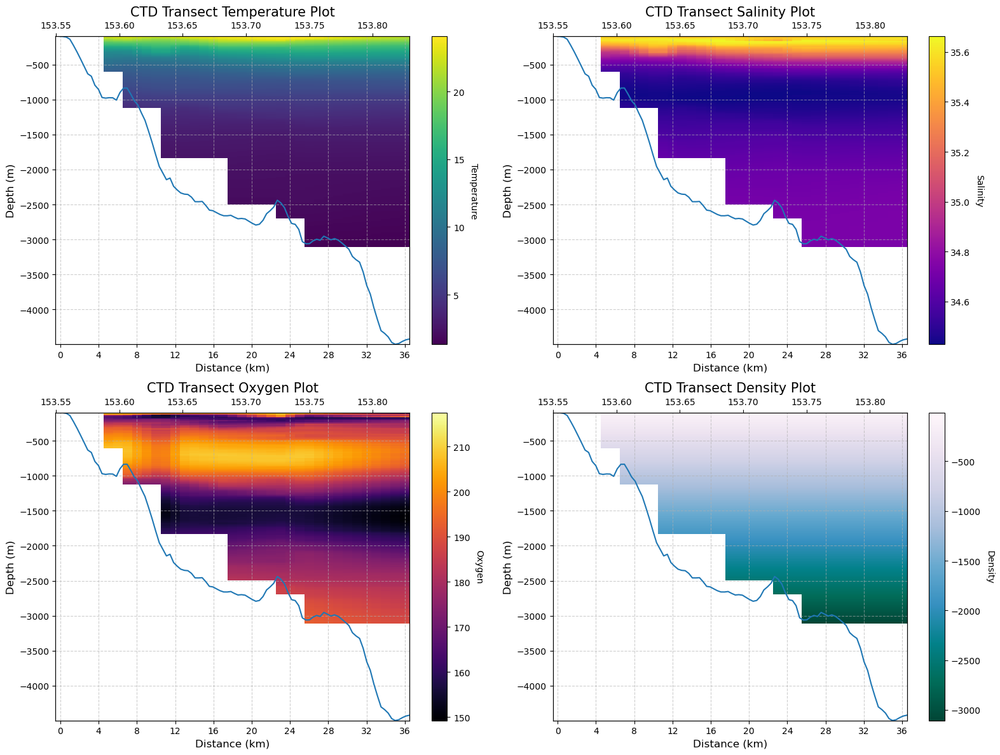

In [95]:
plot_interp_profiles(thalweg_sol,dt_thalweg_sol, sol_b)


In [114]:
sol_b = xr.open_dataset('/Users/isabelaconde/Desktop/Solitary_Island_Canyon_High_Res_Bathy.nc')
rich_b = xr.open_dataset('/Users/isabelaconde/Desktop/RichmondCanyon_50m.nc')

In [85]:
dt_thalweg_sol[len(dt_thalweg_sol)-1]

<xarray.Dataset>
Dimensions:      (longitude: 1, latitude: 1, depth: 4480, time: 1)
Coordinates:
  * latitude     (latitude) float64 -30.2
  * longitude    (longitude) float64 153.8
  * time         (time) datetime64[ns] 2024-06-27T12:24:24.543002112
  * depth        (depth) float64 -4.345 -4.966 -5.959 ... -4.405e+03 -4.406e+03
Data variables:
    temperature  (longitude, latitude, depth, time) float64 22.2 22.2 ... 1.19
    salinity     (longitude, latitude, depth, time) float64 35.55 ... 34.72
    oxygen       (longitude, latitude, depth, time) float64 202.7 ... 191.5
    density      (longitude, latitude, depth, time) float64 -4.345 ... -4.406...
    pressure     (depth) float64 4.375 5.0 6.0 ... 4.481e+03 4.482e+03 4.483e+03

In [83]:
ctd_096

<xarray.Dataset>
Dimensions:      (longitude: 1, latitude: 1, depth: 4480, time: 1)
Coordinates:
  * latitude     (latitude) float64 -30.2
  * longitude    (longitude) float64 153.8
  * time         (time) datetime64[ns] 2024-06-27T12:24:24.543002112
  * depth        (depth) float64 -4.345 -4.966 -5.959 ... -4.405e+03 -4.406e+03
Data variables:
    temperature  (longitude, latitude, depth, time) float64 22.2 22.2 ... 1.19
    salinity     (longitude, latitude, depth, time) float64 35.55 ... 34.72
    oxygen       (longitude, latitude, depth, time) float64 202.7 ... 191.5
    density      (longitude, latitude, depth, time) float64 -4.345 ... -4.406...
    pressure     (depth) float64 4.375 5.0 6.0 ... 4.481e+03 4.482e+03 4.483e+03

In [90]:
start_lat, start_lon =dt_thalweg_sol[0].latitude.values[0],  dt_thalweg_sol[0].longitude.values[0]  
end_lat, end_lon =dt_thalweg_sol[len(dt_thalweg_sol)-1].latitude.values[0],  dt_thalweg_sol[len(dt_thalweg_sol)-1].longitude.values[0]    # Replace with your actual end point
num_points = 100  # Number of points along the transect
lats = np.linspace(start_lat, end_lat, num_points)
lons = np.linspace(start_lon, end_lon, num_points)
transect_data = sol_b.interp(lat=xr.DataArray(lats, dims="points"), lon=xr.DataArray(lons, dims="points"))


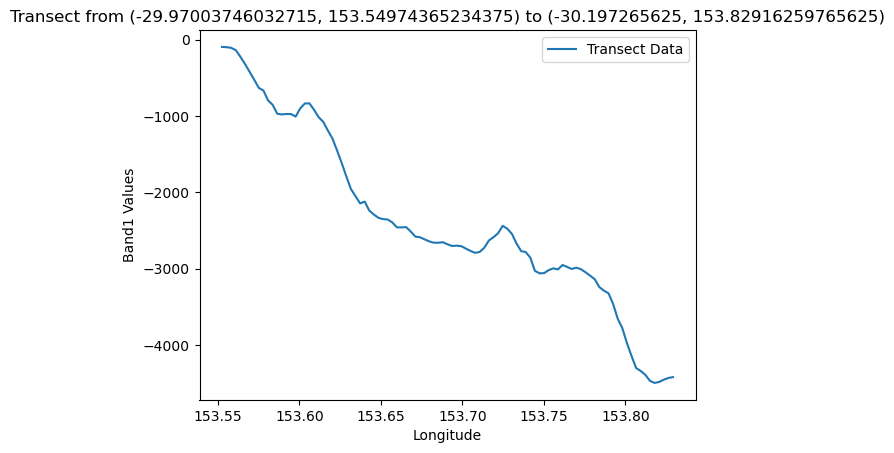

In [91]:
import matplotlib.pyplot as plt

plt.plot(transect_data['lon'], transect_data['Band1'], label='Transect Data')
plt.xlabel('Longitude')
plt.ylabel('Band1 Values')
plt.title('Transect from ({}, {}) to ({}, {})'.format(start_lat, start_lon, end_lat, end_lon))
plt.legend()
plt.show()
